<a href="https://colab.research.google.com/github/Jarvis-X/Swarms-Course-Projects/blob/main/SwarmsHW1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Hah! Let's make something fun. 

We have a rectanglular area in $2D$ of size $l\times h$ along axes $\boldsymbol{x}$ and $\boldsymbol{y}$, of which the lower left corner is placed at $\left(-\frac{l}{2}, 0\right)$. The walls of the rectangle are not penetrable, which define the ***playground*** of this simulation. 
We release a number of $n$ circular unactuated objects in the playground and simulate the motion of these objects. We highlight an additional rule that the bounding walls boost/nerf the velocity of the circular objects by $p_x\% \text{ and } p_y\%$, *i.e.*, if an object collides with a vertical wall with a velocity vector of $\boldsymbol{v} = \left[v_x, v_y\right]$, then its velocity becomes $\left[-\left(1+\frac{p_x}{100}\right)v_x, v_y\right]$ after the impact. The objects can collide with each other while perserving their momentum and kinetic energy up to a maximum impact force.

<!-- A partial standard parabolic ramp of the form $y=x^2$ is fixed in this playground, ranging from $x_{l}$ to $x_{r}$ along the $\boldsymbol{x}$-axis. -->

In [193]:
# imports and parameters
import numpy as np
l = 4
h = 2
xl = -0.7
xr = 0.3
n = 10
percentx = 15
percenty = -2
# friction coefficient of the ramp
mu = 0.25

# air damping (f = -ad*v)
ad = 0.005
# surface damping
sd = 0.01
# mass mean of each object
mm = 0.5
# mass variation of each object
vm = 0.25
# radius mean of each object
mr = 0.1
# radius variation of each object
vr = 0.025
# gravity constant
g = 9.8
# time step
dt = 0.0002
# total time of simulation
time_out = 10
# damping?
enable_damping = False
# friction?
enable_friction = False
discount_factor = 0.98
max_force = 10000

class PointObject():
    def __init__(self, init_states, mass, radius):
        self.mass = mass
        self.states = np.copy(init_states)
        self.radius = radius
        self.received_force = np.array([0., -self.mass*g])

    def get_states(self):
        return self.states

    def get_mass(self):
        return self.mass
    
    def get_radius(self):
        return self.radius

    def iscolliding(self, other):
        other_states = other.get_states()
        other_radius = other.get_radius()
        dist = discount_factor*distance(self.states[0:2], other_states[0:2])
        
        if dist <= self.radius + other_radius:
            return True
        else:
            return False
    
    def colliding_another(self, other, dt):
        mA = self.mass
        mB = other.get_mass()
        rA = self.radius
        rB = other.get_radius()
        pAx, pAy, vAx, vAy = self.states
        pBx, pBy, vBx, vBy = other.get_states()
        AB = np.array([pBx - pAx, pBy - pAy])
        dist = np.linalg.norm(AB)
        normal = AB/dist
        # There is a problem with Euler integration. We trick it by force two 
        # objects to seperate when colliding
        delta_d = rA + rB - discount_factor*dist
        self_compensate = -normal*delta_d*rA/(rA + rB)
        other_compensate = normal*delta_d*rB/(rA + rB)
        self.update_states(self.states + np.array([self_compensate[0], self_compensate[1], 0, 0]))
        other.update_states(other.get_states() + np.array([other_compensate[0], other_compensate[1], 0, 0]))
        """
        tangent = np.array([[0, -1], [1, 0]]).dot(normal)
        # the speed of the two objects along the tangent direction before impact
        # which does not change after the collision
        vAt = np.array([vAx, vAy]).dot(tangent)
        vBt = np.array([vBx, vBy]).dot(tangent)
        """
        # the speed of the two objects along the normal direction before impact
        vAn = np.array([vAx, vAy]).dot(normal)
        vBn = np.array([vBx, vBy]).dot(normal)
        # using the conservation of kinetic energy and conservation of the 
        # linear momentum, we obtain the normal speed of the two objects
        vAn_new = 1/(mA + mB)*(2*mB*vBn - mB*vAn + mA*vAn)
        vBn_new = 1/(mA + mB)*(2*mA*vAn - mA*vBn + mB*vBn)
        # then the tricky part: we do not directly update the velocity, we 
        # register the equivalent force using the impulse formula m*dv=f*dt that 
        # should change normal speed of both objects in one time stamp. We make 
        # the update in this way to allow other forces to come into play by
        # superpositioning them
        fnA = max(-max_force, min((vAn_new - vAn)*mA/dt, max_force))*normal
        fnB = max(-max_force, min((vBn_new - vBn)*mB/dt, max_force))*normal
        self.add_force(fnA)
        other.add_force(fnB)

    def colliding_wall_check(self, environment, dt):
        lw_x = environment.get_left_wall_x()
        rw_x = environment.get_right_wall_x()
        ceiling_y = environment.get_ceiling_y()
        floor_y = environment.get_floor_y()
        px, py, vx, vy = self.states
        r = self.radius
        m = self.mass
        if px - r <= lw_x:
            vx_new = np.abs(environment.get_COR_x()*vx)
            self.states[0] = lw_x + r
            self.add_force(np.array([1, 0])*max(-max_force, min((vx_new - vx)*m/dt, max_force)))
        elif px + r >= rw_x:
            vx_new = -np.abs(environment.get_COR_x()*vx)
            self.states[0] = rw_x - r
            self.add_force(np.array([1, 0])*max(-max_force, min((vx_new - vx)*m/dt, max_force)))
        if py - r <= floor_y:
            vy_new = np.abs(environment.get_COR_y()*vy)
            self.states[1] = floor_y + r
            self.add_force(np.array([0, 1])*max(-max_force, min((vy_new - vy)*m/dt, max_force)))
        elif py + r >= ceiling_y:
            vy_new = -np.abs(environment.get_COR_y()*vy)
            self.states[1] = ceiling_y - r
            self.add_force(np.array([0, 1])*max(-max_force, min((vy_new - vy)*m/dt, max_force)))

        # TODO: non-bounding walls
        walls = environment.get_walls()
        
    def colliding_ramp_check(self):
        pass

    def add_force(self, force):
        self.received_force += force
    

    # update the states with the total force
    def update(self):
        self.states[:2] += self.states[2:]*dt
        self.states[2:] += (self.received_force/self.mass)*dt
        self.received_force = np.array([0., -self.mass*g])

    def update_states(self, states):
        self.states = states


class Environment():
    def __init__(self, l, h, percentx, percenty):
        self.length = l
        self.height = h
        self.left_wall_x = -l/2
        self.right_wall_x = l/2
        self.ceiling_y = h
        self.floor_y = 0
        # coefficient of restitution for vertical walls (v2_x = -CoR_x*v1_x)
        self.COR_x = 1 + percentx/100
        # coefficient of restitution for horiozontal walls (v2_y = -CoR_y*v1_y)
        self.COR_y = 1 + percenty/100
        self.walls = []

    def get_left_wall_x(self):
        return self.left_wall_x

    def get_right_wall_x(self):
        return self.right_wall_x
    
    def get_ceiling_y(self):
        return self.ceiling_y

    def get_floor_y(self):
        return self.floor_y
    
    def get_COR_x(self):
        return self.COR_x

    def get_COR_y(self):
        return self.COR_y

    # We can add straight walls, defined by their two endpoints. 
    # We save the two end points' x value and a, b in the form of y = ax + b
    def add_wall(self, pA, pB):
        xA, yA = pA
        xB, yB = pB
        a = (yA - yB)/(xA - xB)
        b = (-xB*yA + xA*yB)/(xA - xB)
        self.walls.append((xA, xB, a, b))
    
    def get_walls(self):
        return self.walls


def distance(pA, pB):
    return np.sqrt((pA[0] - pB[0])**2 + (pA[1] - pB[1])**2)

# initial states, we do not consider rotations
objects = []
state_log = [[] for i in range(n)]
for i in range(n):
    mass = np.random.uniform(mm - vm, mm + vm)
    radius = np.random.uniform(mr - vr, 0.9*l/n/2)
    states = np.zeros((4,))
    start_x = l/n/2*(2*i + 1)- l/2
    start_y = np.random.uniform(0.25*h, 0.75*h)
    start_vx = np.random.uniform(-2*l, 2*l)
    start_vy = start_x**2 + np.random.uniform(-2*h, 2*h)
    states[0] = start_x
    states[1] = start_y
    states[2] = start_vx
    states[3] = start_vy
    state_log[i].append(np.copy(states))
    print(states)
    objects.append(PointObject(states, mass, radius))

# environment!
env = Environment(l, h, percentx, percenty)

# simulation!
length = int(time_out//dt)
for iter in range(length):
    for i in range(n):
        # check collision with other objects
        for j in range(i + 1, n):
            if objects[i].iscolliding(objects[j]):
                # print("{} is colliding {}".format(i, j))
                objects[i].colliding_another(objects[j], dt)
        objects[i].colliding_wall_check(env, dt)
        objects[i].update()
        state_log[i].append(np.copy(objects[i].get_states()))


[-1.8         1.05883125 -1.00375532  3.61181598]
[-1.4         1.17513375  7.85039614  2.90459043]
[-1.          0.60324208  3.77474601  2.04423059]
[-0.6         0.8315996  -7.77168122 -2.31527709]
[-0.2         1.19188493 -7.71757526  2.41659584]
[0.2        1.41345233 5.55247497 0.62341797]
[0.6        1.29933434 7.49452659 3.96721233]
[ 1.          0.76089238  2.50526661 -1.19267621]
[ 1.4         1.0875723  -0.73975457  3.03543714]
[ 1.8         1.22919815 -2.36956097  5.20038202]


In [20]:
!pip install JSAnimation

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


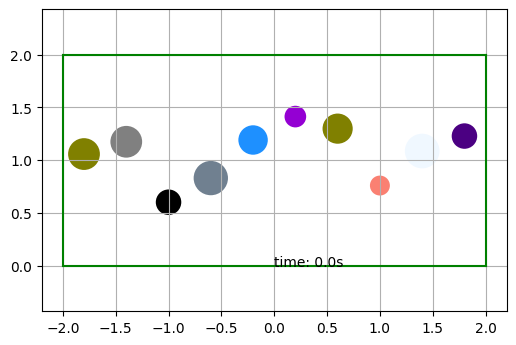

In [194]:
import matplotlib.pyplot as plt
from matplotlib import animation
from JSAnimation import IPython_display
from IPython.display import HTML
from matplotlib.colors import CSS4_COLORS
colors = [name for name, _ in CSS4_COLORS.items()]
object_colors = [np.random.choice(colors) for _ in range(n)]

fig, ax = plt.subplots(dpi=100)
plt.axis('equal')
sampling = int(50)
state_log = np.array(state_log)

def animate(t):
    ax.clear()
    plt.grid()
    plt.plot((-l/2, l/2), (0, 0), 'g')
    plt.plot((l/2, l/2), (0, h), 'g')
    plt.plot((l/2, -l/2), (h, h), 'g')
    plt.plot((-l/2, -l/2), (h, 0), 'g')

    for i in range(n):
        plt.plot(state_log[i, sampling*(t-10):sampling*t:sampling, 0], state_log[i, sampling*(t-10):sampling*t:sampling, 1], '--')
        # current position
        cir = plt.Circle((state_log[i, sampling*t, 0], state_log[i, sampling*t, 1]), 
                         objects[i].get_radius(), fc=object_colors[i])
        ax.add_patch(cir)
        # plt.plot(state_log[i][sampling*t][0], state_log[i][sampling*t][1], 'ko')

    plt.text(0,0,"time: {:.1f}s".format(t*dt*sampling))
    
    
time = int(len(state_log[0])/sampling)
anim = animation.FuncAnimation(fig, animate, frames=time, interval=dt*1000*sampling)
anim.save("video.mp4")
HTML(anim.to_jshtml())